In [ ]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import cm, colors
import pynumdiff


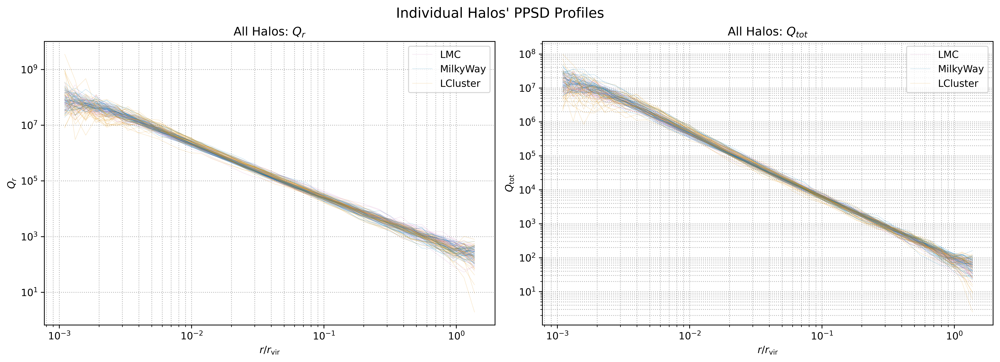

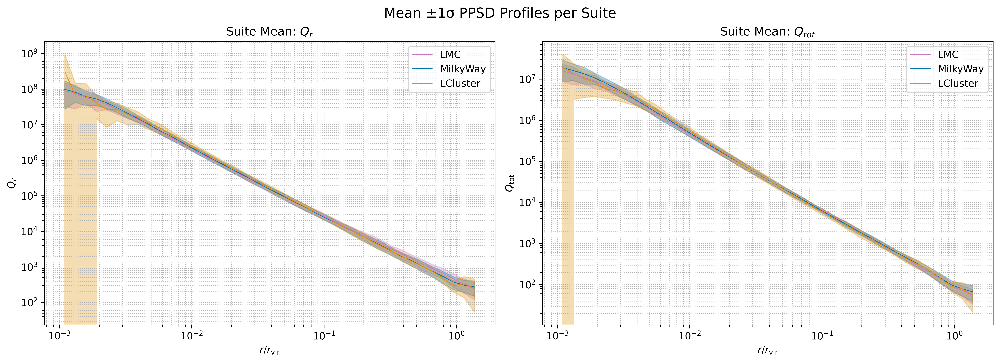

In [24]:
sim_colors = {
    'SymphonyLMC': sns.color_palette("colorblind")[4],
    'SymphonyMilkyWay': sns.color_palette("colorblind")[0],
    'SymphonyGroup': sns.color_palette("colorblind")[2],
    'SymphonyLCluster': sns.color_palette("colorblind")[1],
    'SymphonyCluster': sns.color_palette("colorblind")[3]
}

def load_ppsd_data(base_dir, suite_name):
    density_dir = os.path.join(base_dir, "output", suite_name, "density_profiles")
    velocity_dir = os.path.join(base_dir, "output", suite_name, "velocity_profiles")
    density_files = sorted([f for f in os.listdir(density_dir) if f.endswith(".csv")])
    velocity_files = sorted([f for f in os.listdir(velocity_dir) if f.endswith(".csv")])
    all_Qr, all_Qtot, r_vals = [], [], None
    for f_rho, f_vel in zip(density_files, velocity_files):
        df_rho = pd.read_csv(os.path.join(density_dir, f_rho))
        df_vel = pd.read_csv(os.path.join(velocity_dir, f_vel))
        r = df_rho["r_scaled"].values
        rho = df_rho["rho_scaled"].values
        sigma_rad = df_vel["sigma_rad_scaled"].values
        sigma_total = df_vel["sigma_total_scaled"].values
        with np.errstate(divide="ignore", invalid="ignore"):
            Q_r = np.where(sigma_rad > 0, rho / sigma_rad**3, np.nan)
            Q_tot = np.where(sigma_total > 0, rho / sigma_total**3, np.nan)
        all_Qr.append(Q_r)
        all_Qtot.append(Q_tot)
        if r_vals is None:
            r_vals = r
    return np.array(all_Qr), np.array(all_Qtot), r_vals

def plot_ppsd_individual_halos(base_dir, suite_names):
    output_dir = os.path.join(base_dir, "output", "combined_figures")
    os.makedirs(output_dir, exist_ok=True)
    fig, axes = plt.subplots(1, 2, figsize=(14, 5), dpi=600, constrained_layout=True)

    for suite_name in suite_names:
        Qr_all, Qtot_all, r = load_ppsd_data(base_dir, suite_name)
        color = sim_colors.get(suite_name, "gray")
        label = suite_name.replace("Symphony", "")
        first_curve = True  
        for Qr, Qt in zip(Qr_all, Qtot_all):
            if first_curve:
                axes[0].plot(r, Qr, color=color, lw=0.5, alpha=0.2, label=label)
                axes[1].plot(r, Qt, color=color, lw=0.5, alpha=0.2, label=label)
                first_curve = False
            else:
                axes[0].plot(r, Qr, color=color, lw=0.5, alpha=0.2)
                axes[1].plot(r, Qt, color=color, lw=0.5, alpha=0.2)

    axes[0].set(xscale="log", yscale="log", xlabel=r"$r / r_{\rm vir}$", ylabel=r"$Q_r$", title="All Halos: $Q_r$")
    axes[1].set(xscale="log", yscale="log", xlabel=r"$r / r_{\rm vir}$", ylabel=r"$Q_{\rm tot}$", title="All Halos: $Q_{tot}$")

    for ax in axes:
        ax.grid(True, which="both", linestyle=":")
        ax.legend() 
    plt.suptitle("Individual Halos' PPSD Profiles", fontsize=14)
    fig.savefig(os.path.join(output_dir, "PPSD_individual_halos.png"))
    plt.show()
    plt.close(fig)

def plot_ppsd_mean_profiles(base_dir, suite_names):
    output_dir = os.path.join(base_dir, "output", "combined_figures")
    os.makedirs(output_dir, exist_ok=True)
    fig, axes = plt.subplots(1, 2, figsize=(14, 5), dpi=600, constrained_layout=True)

    for suite_name in suite_names:
        Qr_all, Qtot_all, r = load_ppsd_data(base_dir, suite_name)
        mean_Qr = np.nanmean(Qr_all, axis=0)
        std_Qr = np.nanstd(Qr_all, axis=0)
        mean_Qtot = np.nanmean(Qtot_all, axis=0)
        std_Qtot = np.nanstd(Qtot_all, axis=0)
        color = sim_colors.get(suite_name, "gray")
        label = suite_name.replace("Symphony", "")
        axes[0].plot(r, mean_Qr, color=color, lw=0.7, label=label)
        axes[0].fill_between(r, mean_Qr - std_Qr, mean_Qr + std_Qr, color=color, alpha=0.3)
        axes[1].plot(r, mean_Qtot, color=color, lw=0.7, label=label)
        axes[1].fill_between(r, mean_Qtot - std_Qtot, mean_Qtot + std_Qtot, color=color, alpha=0.3)
    axes[0].set(xscale="log", yscale="log", xlabel=r"$r / r_{\rm vir}$", ylabel=r"$Q_r$", title="Suite Mean: $Q_r$")
    axes[1].set(xscale="log", yscale="log", xlabel=r"$r / r_{\rm vir}$", ylabel=r"$Q_{\rm tot}$", title="Suite Mean: $Q_{tot}$")

    for ax in axes:
        ax.grid(True, which="both", linestyle=":")
        ax.legend()

    plt.suptitle("Mean ±1σ PPSD Profiles per Suite", fontsize=14)
    fig.savefig(os.path.join(output_dir, "PPSD_suite_mean.png"))
    plt.show()
    plt.close(fig)

base_dir = "/Volumes/Atlas/Symphony"
suite_names = ["SymphonyLMC", "SymphonyMilkyWay", "SymphonyLCluster"]
plot_ppsd_individual_halos(base_dir, suite_names)
plot_ppsd_mean_profiles(base_dir, suite_names)

In [ ]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import pynumdiff
import pynumdiff.kalman_smooth
import pynumdiff.optimize.kalman_smooth
import symlib

def load_ppsd_profiles(base_dir, suite_name):
    density_dir = os.path.join(base_dir, "output", suite_name, "density_profiles")
    velocity_dir = os.path.join(base_dir, "output", suite_name, "velocity_profiles")
    mass_dir = os.path.join(base_dir, "output", suite_name, "mass_profiles")

    density_files = sorted([f for f in os.listdir(density_dir) if f.endswith(".csv")])
    velocity_files = sorted([f for f in os.listdir(velocity_dir) if f.endswith(".csv")])
    mass_files = sorted([f for f in os.listdir(mass_dir) if f.endswith(".csv")])
    
    all_Qr = []
    all_Qtot = []
    all_r = []
    all_m = []
    
    for f_rho, f_vel, f_mass in zip(density_files, velocity_files, mass_files):
        df_rho = pd.read_csv(os.path.join(density_dir, f_rho))
        df_vel = pd.read_csv(os.path.join(velocity_dir, f_vel))
        df_mass = pd.read_csv(os.path.join(mass_dir, f_mass))

        r = df_rho["r_scaled"].values
        rho = df_rho["rho_scaled"].values
        sigma_rad = df_vel["sigma_rad_scaled"].values
        sigma_tot = df_vel["sigma_total_scaled"].values
        mass = df_mass["m_scaled"].values

        with np.errstate(divide='ignore', invalid='ignore'):
            Qr = np.where(sigma_rad > 0, rho / sigma_rad**3, np.nan)
            Qtot = np.where(sigma_tot > 0, rho / sigma_tot**3, np.nan)

        all_Qr.append(Qr)
        all_Qtot.append(Qtot)
        all_r.append(r)
        all_m.append(mass)

    return np.array(all_Qr), np.array(all_Qtot), np.array(all_r), np.array(all_m)

def compute_kalman_slopes(log_x, log_y):
    valid = np.isfinite(log_y) & np.isfinite(log_x)
    if np.sum(valid) < 5:
        return None
    dt = np.mean(np.diff(log_x[valid]))
    try:
        params, _ = pynumdiff.optimize.kalman_smooth.constant_jerk(log_y[valid], dt)
        _, slope = pynumdiff.kalman_smooth.constant_jerk(log_y[valid], dt, params)
    except Exception:
        return None
    slope_full = np.full_like(log_x, np.nan)
    slope_full[valid] = slope
    return slope_full

def plot_ppsd_slopes_all_and_mean(base_dir, suite_names):
    colors = {
        "SymphonyLMC": "C4",
        "SymphonyMilkyWay": "C0",
        "SymphonyGroup": "C2",
        "SymphonyLCluster": "C1",
        "SymphonyCluster": "C3"
    }

    # Prepare figure for halos (all individual)
    fig_all, axes_all = plt.subplots(2, 2, figsize=(14, 10), dpi=600, constrained_layout=True)
    ax_r_Qr, ax_r_Qtot, ax_m_Qr, ax_m_Qtot = axes_all.flatten()

    # Prepare figure for mean profiles
    fig_mean, axes_mean = plt.subplots(2, 2, figsize=(14, 10), dpi=600, constrained_layout=True)
    ax_r_Qr_m, ax_r_Qtot_m, ax_m_Qr_m, ax_m_Qtot_m = axes_mean.flatten()

    for suite_name in suite_names:
        Qr_all, Qtot_all, r_all, m_all = load_ppsd_profiles(base_dir, suite_name)
        color = colors.get(suite_name, "gray")
        
        slopes_r_Qr = []
        slopes_r_Qtot = []
        slopes_m_Qr = []
        slopes_m_Qtot = []
                
        first_curve = True  

        for Qr, Qtot, r, m in zip(Qr_all, Qtot_all, r_all, m_all):
            log_r = np.log10(r)
            log_m = np.log10(m)
            log_Qr = np.log10(Qr)
            log_Qtot = np.log10(Qtot)

            slope_r_Qr = compute_kalman_slopes(log_r, log_Qr)
            slope_r_Qtot = compute_kalman_slopes(log_r, log_Qtot)
            slope_m_Qr = compute_kalman_slopes(log_m, log_Qr)
            slope_m_Qtot = compute_kalman_slopes(log_m, log_Qtot)

            if slope_r_Qr is not None:
                slopes_r_Qr.append(slope_r_Qr)
                ax_r_Qr.plot(r, slope_r_Qr, color=color, lw=0.5, alpha=0.3,
                            label=suite_name if first_curve else None)
            if slope_r_Qtot is not None:
                slopes_r_Qtot.append(slope_r_Qtot)
                ax_r_Qtot.plot(r, slope_r_Qtot, color=color, lw=0.5, alpha=0.3,
                            label=suite_name if first_curve else None)
            if slope_m_Qr is not None:
                slopes_m_Qr.append(slope_m_Qr)
                ax_m_Qr.plot(m, slope_m_Qr, color=color, lw=0.5, alpha=0.3,
                            label=suite_name if first_curve else None)
            if slope_m_Qtot is not None:
                slopes_m_Qtot.append(slope_m_Qtot)
                ax_m_Qtot.plot(m, slope_m_Qtot, color=color, lw=0.5, alpha=0.3,
                            label=suite_name if first_curve else None)

            first_curve = False  
        # Convert slopes to arrays for mean/std calculation
        slopes_r_Qr = np.array(slopes_r_Qr)
        slopes_r_Qtot = np.array(slopes_r_Qtot)
        slopes_m_Qr = np.array(slopes_m_Qr)
        slopes_m_Qtot = np.array(slopes_m_Qtot)

        # Mean and std profiles
        if slopes_r_Qr.size > 0:
            mean_r_Qr = np.nanmean(slopes_r_Qr, axis=0)
            std_r_Qr = np.nanstd(slopes_r_Qr, axis=0)
            ax_r_Qr_m.plot(r, mean_r_Qr, color=color, lw=1, label=suite_name)
            ax_r_Qr_m.fill_between(r, mean_r_Qr - std_r_Qr, mean_r_Qr + std_r_Qr, color=color, alpha=0.3)

        if slopes_r_Qtot.size > 0:
            mean_r_Qtot = np.nanmean(slopes_r_Qtot, axis=0)
            std_r_Qtot = np.nanstd(slopes_r_Qtot, axis=0)
            ax_r_Qtot_m.plot(r, mean_r_Qtot, color=color, lw=1, label=suite_name)
            ax_r_Qtot_m.fill_between(r, mean_r_Qtot - std_r_Qtot, mean_r_Qtot + std_r_Qtot, color=color, alpha=0.3)

        if slopes_m_Qr.size > 0:
            mean_m_Qr = np.nanmean(slopes_m_Qr, axis=0)
            std_m_Qr = np.nanstd(slopes_m_Qr, axis=0)
            ax_m_Qr_m.plot(m, mean_m_Qr, color=color, lw=1, label=suite_name)
            ax_m_Qr_m.fill_between(m, mean_m_Qr - std_m_Qr, mean_m_Qr + std_m_Qr, color=color, alpha=0.3)

        if slopes_m_Qtot.size > 0:
            mean_m_Qtot = np.nanmean(slopes_m_Qtot, axis=0)
            std_m_Qtot = np.nanstd(slopes_m_Qtot, axis=0)
            ax_m_Qtot_m.plot(m, mean_m_Qtot, color=color, lw=1, label=suite_name)
            ax_m_Qtot_m.fill_between(m, mean_m_Qtot - std_m_Qtot, mean_m_Qtot + std_m_Qtot, color=color, alpha=0.3)

    for ax in axes_all.flatten():
        ax.axhline(-1.875, color='k', linestyle='--', lw=1)
        ax.set_xscale("log")
        ax.set_ylim(-3, 0)
        ax.grid(True, which="both", linestyle=":")
        ax.legend()

    ax_r_Qr.set_title(r"All halos: $d\log Q_r / d\log r$")
    ax_r_Qtot.set_title(r"All halos: $d\log Q_{tot} / d\log r$")
    ax_m_Qr.set_title(r"All halos: $d\log Q_r / d\log M$")
    ax_m_Qtot.set_title(r"All halos: $d\log Q_{tot} / d\log M$")
    ax_r_Qr.set_xlabel(r"$r / r_{\rm vir}$")
    ax_r_Qtot.set_xlabel(r"$r / r_{\rm vir}$")
    ax_m_Qr.set_xlabel(r"$M(<r) / M_{\rm vir}$")
    ax_m_Qtot.set_xlabel(r"$M(<r) / M_{\rm vir}$")
    ax_r_Qr.set_ylabel("Slope")
    ax_r_Qtot.set_ylabel("Slope")
    ax_m_Qr.set_ylabel("Slope")
    ax_m_Qtot.set_ylabel("Slope")

    fig_all.suptitle("Individual Halo PPSD Slopes (Kalman)", fontsize=16)

    for ax in axes_mean.flatten():
        ax.axhline(-1.875, color='k', linestyle='--', lw=1)
        ax.set_xscale("log")
        ax.set_ylim(-3, 0)
        ax.grid(True, which="both", linestyle=":")
        ax.legend()

    ax_r_Qr_m.set_title(r"Mean PPSD Slope $Q_r$ vs $r$")
    ax_r_Qtot_m.set_title(r"Mean PPSD Slope $Q_{tot}$ vs $r$")
    ax_m_Qr_m.set_title(r"Mean PPSD Slope $Q_r$ vs $M$")
    ax_m_Qtot_m.set_title(r"Mean PPSD Slope $Q_{tot}$ vs $M$")
    ax_r_Qr_m.set_xlabel(r"$r / r_{\rm vir}$")
    ax_r_Qtot_m.set_xlabel(r"$r / r_{\rm vir}$")
    ax_m_Qr_m.set_xlabel(r"$M(<r) / M_{\rm vir}$")
    ax_m_Qtot_m.set_xlabel(r"$M(<r) / M_{\rm vir}$")
    ax_r_Qr_m.set_ylabel("Slope")
    ax_r_Qtot_m.set_ylabel("Slope")
    ax_m_Qr_m.set_ylabel("Slope")
    ax_m_Qtot_m.set_ylabel("Slope")

    fig_mean.suptitle("Mean ±1σ PPSD Slopes by Suite (Kalman)", fontsize=16)

    output_dir = os.path.join(base_dir, "output", "combined", "figures")
    os.makedirs(output_dir, exist_ok=True)
    fig_all.savefig(os.path.join(output_dir, "PPSD_slopes_all_halos.png"), dpi=600)
    fig_mean.savefig(os.path.join(output_dir, "PPSD_slopes_mean_profiles.png"), dpi=600)

    plt.show()
    plt.close(fig_all)
    plt.close(fig_mean)

base_dir = "/Volumes/Atlas/Symphony"
suite_names = ["SymphonyMilkyWay", "SymphonyLMC", "SymphonyLCluster"]

plot_ppsd_slopes_all_and_mean(base_dir, suite_names)

/var/folders/ws/425czmvd4jn8yf9hxr3xtk880000gn/T/ipykernel_7285/1950262630.py:90: RuntimeWarning: divide by zero encountered in log10
  log_m = np.log10(m)
